# **Lab 2.1 Image Enhancement with Math Operation**
This lab consists of two main subparts: Image Pixel Adjustment using Linear Equations and Gamma Equations.

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.axes_grid1 import ImageGrid
import os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

Read an image using OpenCV (Use your own image).

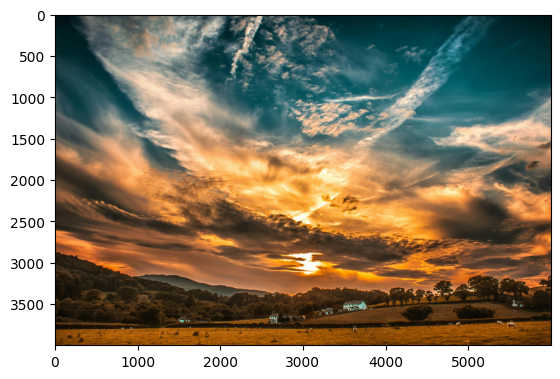

In [2]:
### START CODE HERE ###
img = cv2.cvtColor(cv2.imread(r'C:\Users\Nickv\Documents\ImageProcessing\Week2\asset\sky.jpg'), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.show()
### END CODE HERE ###

## **Image Pixel Adjustment**

### Using Linear Equation
$$I_{new} = I \cdot a + b$$

Please perform at ***least 20 iterations*** with varying values of $a$ and $b$.
Assign the result of each iteration to an array.<br/>

In [3]:
### START CODE HERE ###
a = 0
b = 0
lin_result = []

for i in range(40):
    lin_result.append((img * a + b).clip(0, 255).astype(np.uint8))
    a += 0.05
    b += 0.05


### END CODE HERE ###

Plot the images in a grid as shown below. Using `ImageGrid`.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical
- The reference output used 40 iterations.

![image-2.png](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab2_Image-Enhancement/assets/1-1.png?raw=true)
</details>


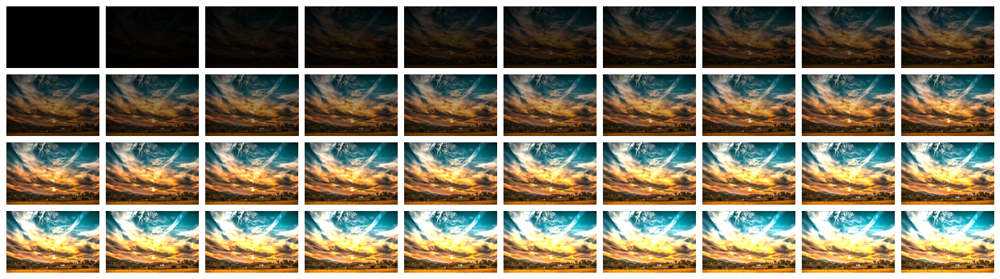

In [4]:
### START CODE HERE ###

fig = plt.figure(figsize=(20, 20))
grid = ImageGrid(fig, 111, nrows_ncols=(4, 10), axes_pad=0.1)

for ax, im in zip(grid, lin_result):
    ax.imshow(im)
    ax.axis('off')


plt.show()
### END CODE HERE ###

If you code work properly, the cell below should run without error.

In [5]:
assert len(lin_result) >= 20, f"Expected more than or equal 20 iterations but got {len(lin_result)}"
for idx, result in enumerate(lin_result):
    assert result.shape == img.shape, f"Shape mismatch at index {idx}. Expected {img.shape} but got {result.shape}"
    assert result.dtype == np.uint8, f"Data type mismatch at index {idx}. Expected uint8 but got {result.dtype}"
    assert np.all((result >= 0) & (result <= 255)), f"Pixel value out of bounds at index {idx}"

Save the array of images to a video. Please complete the function below.

In [6]:
### START CODE HERE ###
def write_images_to_video(image_array, output_file, frame_rate=30):

    height, width, layers = image_array[0].shape
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_file, fourcc, frame_rate, (width, height))
    for image in image_array:
        out.write(image)
        
    out.release()
    return out

### END CODE HERE ###

Use `write_images_to_video()` and save the result.

In [7]:
output_folder = "output"
os.makedirs(output_folder, exist_ok=True)

output_file =  os.path.join(output_folder, "output_linear.mp4")
write_images_to_video(lin_result,output_file)

< cv2.VideoWriter 0000027E5D461D10>

Now use `matplotlib.animation` to display the animation from the images array.

In [8]:
%%capture
### START CODE HERE ###
plt.rcParams['animation.embed_limit'] = 60
fig, axs = plt.subplots()

ims = []
for image in lin_result:
    im = axs.imshow(image, animated=True)
    ims.append([im])


ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True)
output_folder = "output"
output_file =  os.path.join(output_folder, "animation.gif")
writer = animation.PillowWriter(fps=30)
ani.save(output_file, writer=writer)

plt.show()
### END CODE HERE ###

<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![linear.gif](![<attachment:linear (2).gif>](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab2_Image-Enhancement/assets/linear.gif?raw=true))

</details>

In [9]:
display(HTML(ani.to_jshtml()))

### Gamma Equation
$$I_{new} = I^{\gamma} \cdot a + b$$

Where $a$ is 1 and $b$ is 0. 
Please perform ***at least 10 iterations*** for 0 < $\gamma$ < 2 and another ***at least 10 iterations*** for $\gamma$ > 1
Assign the result of each iteration to an array.<br/>


In [10]:
### START CODE HERE ###
a = 1
b = 0
gamma = 0.1

gam_result = []
for i in range(10):
    gam_result.append(((((img / 255.0) ** gamma) * a + b) * 255.0).clip(0, 255).astype(np.uint8))
    gamma += 0.09

for i in range(10):
    gam_result.append(((((img / 255.0) ** gamma) * a + b) * 255.0).clip(0, 255).astype(np.uint8))
    gamma += 0.09

### END CODE HERE ###

Plot the images in a grid as shown below. Using `ImageGrid`.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image-2.png](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab2_Image-Enhancement/assets/1-2.png?raw=true)
</details>

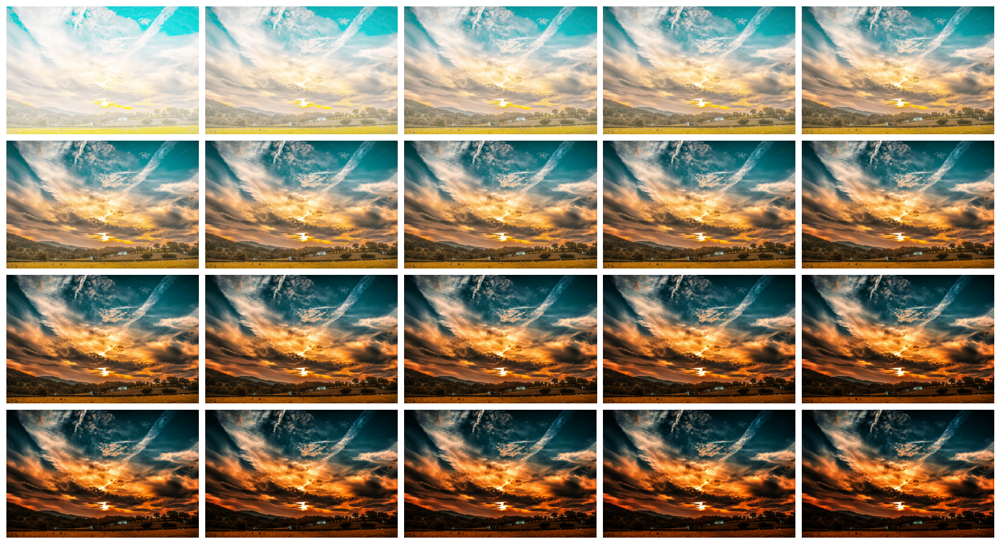

In [11]:
### START CODE HERE ###

fig = plt.figure(figsize=(20, 20))
grid = ImageGrid(fig, 111, nrows_ncols=(4, 5), axes_pad=0.1)

for ax, im in zip(grid, gam_result):
    ax.imshow(im)
    ax.axis('off')


plt.show()

### END CODE HERE ###

In [12]:
assert len(gam_result) == 20, f"Expected {20} iterations but got {len(gam_result)}"
for idx, result in enumerate(gam_result):
    assert result.shape == img.shape, f"Shape mismatch at index {idx}. Expected {img.shape} but got {result.shape}"
    assert result.dtype == np.uint8, f"Data type mismatch at index {idx}. Expected uint8 but got {result.dtype}"
    assert np.all((result >= 0) & (result <= 255)), f"Pixel value out of bounds at index {idx}"

Use `write_images_to_video()` and save the result.

In [13]:
output_folder = "output"
os.makedirs(output_folder, exist_ok=True)

output_file =  os.path.join(output_folder, "output_gamma.mp4")
write_images_to_video(gam_result,output_file)

< cv2.VideoWriter 0000027E303086F0>

Now use `matplotlib.animation` to display the animation from the images array.

In [14]:
%%capture
### START CODE HERE ###

plt.rcParams['animation.embed_limit'] = 60
fig, axs = plt.subplots()

ims = []
for image in gam_result:
    im = axs.imshow(image, animated=True)
    ims.append([im])


ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True)
output_folder = "output"
output_file =  os.path.join(output_folder, "gamma.gif")
writer = animation.PillowWriter(fps=30)
ani.save(output_file, writer=writer)

plt.show()

### END CODE HERE ###

<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![gamma2.gif](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab2_Image-Enhancement/assets/gamma.gif?raw=true)

</details>

In [15]:
display(HTML(ani.to_jshtml()))

---

## **Questions**
1. If an image having over brightness or saturation, what would be possible solutions to enhance the image.
2. How can we make an image reverse intensity (black-to-white, white-to-black)? Explain the process

1. สามารถลดเเสงได้ 2 วิธี วิธีเเรกใช้ Linear equation: Inew = a * I + b โดยลดค่า b เพื่อลดเเสง 
   วิธีที่ 2 ใช้ Gamma equation: Inew = a * I ^ gamma + b โดยเพิ่มค่า gamma เพื่อลดเเสง
2. ใช้ Function bitwise_not() เพื่อกลับ bit จาก 0 เป็น 1 จาก 1 เป็น 0 หรือนำ 255 ซึ่งเป็นค่าสูงสุดของรูป uint8 มาลบด้วยรูปเพื่อ reverse bit 